In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

import matplotlib.pyplot as plt # for plotting
import seaborn as sns           # for plotting
sns.set_style('darkgrid')

# Import Regression Model
from xgboost import XGBRegressor
from sklearn.linear_model import Ridge,Lasso,BayesianRidge
from sklearn.metrics import mean_absolute_percentage_error
from lightgbm import log_evaluation, early_stopping, LGBMRegressor

# For tuning the model
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import uniform, randint
from sklearn.model_selection import KFold

# For measureing processing time
import time

# Used to ignore the warning given as output of the code.
import warnings
warnings.filterwarnings('ignore')

In [2]:
#path='/kaggle/input/playground-series-s5e1/'
#gdp_path = '/kaggle/input/world-gdpgdp-gdp-per-capita-and-annual-growths/'
#atp_path = '/kaggle/input/temperature-of-all-countries-19952020/'
path=gdp_path=atp_path='../Data/'
columns = ('id', 'date', 'country', 'store', 'product', 'num_sold')
ID, DATE, COUNTRY, STORE, PRODUCT, NUM_SOLD = columns
gdp_columns = ('country', 'code', *(str(yr) for yr in range(2010,2020)))
GDP_COUNTRY, GDP_CODE, GDP_2010, GDP_2011, GDP_2012, GDP_2013, GDP_2014, GDP_2015, GDP_2016, GDP_2017, GDP_2018, GDP_2019 = gdp_columns
atp_columns = ('region', 'country', 'state', 'city', 'month', 'day', 'year', 'average_temperature')
ATP_REGIOON, ATP_COUNTRY, ATP_STATE, ATP_CITY, MONTH, DAY, YEAR, ATP_TEMPERATURE = atp_columns
train_df = pd.read_csv(
    path + 'train.csv',                                # Path to input file.
    header = 0,                                        # Header in line 0.
    names = columns,                                   # Column labels defined.
    index_col = ID,                                    # ID column used for index.
    usecols = columns,                                 # Specify colomns to import.
    skipinitialspace=True,                             # Skip space around ends.
    parse_dates = [DATE],                              # Parse date objects.
    date_format = "%Y-%m-%d",                          # assume this form of date string in data.
    encoding = "ascii",                                # Assume ascii encoding for input data.
)
test_df = pd.read_csv(
    path + 'test.csv',                                 # Path to input file.
    header = 0,                                        # Header in line 0.
    names = columns[:-1],                              # Column labels defined.
    index_col = ID,                                    # ID column used for index.
    usecols = columns[:-1],                            # Specify colomns to import (NUM_SOLD not available in testset).
    skipinitialspace=True,                             # Skip space around ends.
    parse_dates = [DATE],                              # Parse date objects.
    date_format = "%Y-%m-%d",                          # assume this form of date string in data.
    encoding = "ascii",                                # Assume ascii encoding for input data.
)
submission_df = pd.read_csv(
    path + 'sample_submission.csv',                    # Path to input file.
    header = 0,                                        # Header in line 0.
    names = [ID,NUM_SOLD],                             # Column labels defined.
    index_col = ID,                                    # ID column used for index.
    usecols = [ID, NUM_SOLD],                          # Specify colomns to import (skip the first one).
    skipinitialspace=True,                             # Skip space around ends.
    encoding = "ascii",                                # Assume ascii encoding for input data.
)
gdp_per_capita_df = pd.read_csv(
    gdp_path + 'gdp_per_capita.csv',                   # Path to input file.
    header = 0,                                        # Header in line 0.
    names = [*gdp_columns[:2], *(str(yr) 
              for yr in range(1960,2021)), 'junk'],    # Column labels defined (hods years from 1960-2020).
    index_col = GDP_CODE,                              # CODE column used for index (three letter country abbreviation).
    usecols = gdp_columns,                             # Specify colomns to import.
    skipinitialspace=True,                             # Skip space around ends.
    quotechar='"',                                     # Quote character is "".
    encoding = "ascii",                                # Assume ascii encoding for input data.
)
#atp_temperature_df = pd.read_csv(
#    atp_path + 'city_temperature.csv',                 # Path to input file.
#    header = 0,                                        # Header in line 0.
#    names = atp_columns,                               # Column labels defined.
#    usecols = atp_columns,                             # Specify colomns to import.
#    na_values='-99',                                   # Used for missing value in data.
#    converters = {
#      ATP_TEMPERATURE:                                 # Convert Fahrenheit to Celcius (not really needed).
#        lambda x:  
#          (((float(x) - 32) * 5.0) / 9.0) 
#          if x != '-99' else None,
#    },
#    skipinitialspace=True,                             # Skip space around ends.
#    encoding = "ascii",                                # Assume ascii encoding for input data.
#)

In [3]:
# GDP processing (used for imputing below).
GDP_RATIO = 'gdp_country_ratio'
years =  gdp_columns[2:]
gdp_per_capita_ratios_df = gdp_per_capita_df.loc[
  gdp_per_capita_df[GDP_COUNTRY].isin(train_df[COUNTRY].unique())
].set_index(GDP_COUNTRY).assign(**{
  yr: lambda x,y=yr: x[y] / x.sum()[y] for yr in years
}).melt(value_vars=years, var_name=DATE, value_name=GDP_RATIO, ignore_index=False).reset_index().assign(**{
  DATE: lambda x: pd.to_datetime(x[DATE], format='%Y')
}).assign(**{YEAR: lambda x: x[DATE].dt.year})
gdp_per_capita_ratios_df

,country,date,gdp_country_ratio,year
0,Canada,2010-01-01,0.178782,2010
1,Finland,2010-01-01,0.174639,2010
2,Italy,2010-01-01,0.135323,2010
3,Kenya,2010-01-01,0.004061,2010
4,Norway,2010-01-01,0.329634,2010
5,Singapore,2010-01-01,0.177560,2010
6,Canada,2011-01-01,0.175553,2011
7,Finland,2011-01-01,0.171715,2011
8,Italy,2011-01-01,0.129753,2011
9,Kenya,2011-01-01,0.003649,2011


Remarks
- Converting date strings to date objects when inputting data.
- Use the ID column in input data for index in the data frames - this column is not used for data analysis anyway.

Defined variables:
- **path**:  path to input data.
- **columns**:  list of column names in the train dataset.
- **ID, DATE, COUNTRY, STORE, PRODUCT, NUM_SOLD**: the string constants holding the names of the data columns.

In [4]:
train_df.head(), train_df.tail()

(         date country              store             product  num_sold
 id                                                                    
 0  2010-01-01  Canada  Discount Stickers   Holographic Goose       NaN
 1  2010-01-01  Canada  Discount Stickers              Kaggle     973.0
 2  2010-01-01  Canada  Discount Stickers        Kaggle Tiers     906.0
 3  2010-01-01  Canada  Discount Stickers            Kerneler     423.0
 4  2010-01-01  Canada  Discount Stickers  Kerneler Dark Mode     491.0,
              date    country                 store             product  \
 id                                                                       
 230125 2016-12-31  Singapore  Premium Sticker Mart   Holographic Goose   
 230126 2016-12-31  Singapore  Premium Sticker Mart              Kaggle   
 230127 2016-12-31  Singapore  Premium Sticker Mart        Kaggle Tiers   
 230128 2016-12-31  Singapore  Premium Sticker Mart            Kerneler   
 230129 2016-12-31  Singapore  Premium Sticke

In [5]:
train_df.nunique()

date        2557
country        6
store          3
product        5
num_sold    4037
dtype: int64

In [6]:
train_df[DATE].max()-train_df[DATE].min(),train_df[DATE].nunique(),test_df[DATE].max()-test_df[DATE].min(),test_df[DATE].nunique()

(Timedelta('2556 days 00:00:00'), 2557, Timedelta('1094 days 00:00:00'), 1095)

In [7]:
train_df[[COUNTRY,STORE,PRODUCT]].value_counts().unique(),test_df[[COUNTRY,STORE,PRODUCT]].value_counts().unique()

(array([2557]), array([1095]))

In [8]:
train_df.shape,2557*(train_df[COUNTRY].nunique()*train_df[STORE].nunique()*train_df[PRODUCT].nunique()),test_df.shape,1095*(test_df[COUNTRY].nunique()*test_df[STORE].nunique()*test_df[PRODUCT].nunique())

((230130, 5), 230130, (98550, 4), 98550)

Remarks
- Train data has values from 1 January 2010 to 31 December 2016.
- Test data has values from 1 January 2017 to 31 December 2019.
- Train and test datasets are time series with values for every single day within the time period.
- Every combination of (COUNTRY, STORE, PRODUCT) have a value for each day.

In [9]:
test_df.info(),train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 98550 entries, 230130 to 328679
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   date     98550 non-null  datetime64[ns]
 1   country  98550 non-null  object        
 2   store    98550 non-null  object        
 3   product  98550 non-null  object        
dtypes: datetime64[ns](1), object(3)
memory usage: 3.8+ MB
<class 'pandas.core.frame.DataFrame'>
Index: 230130 entries, 0 to 230129
Data columns (total 5 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   date      230130 non-null  datetime64[ns]
 1   country   230130 non-null  object        
 2   store     230130 non-null  object        
 3   product   230130 non-null  object        
 4   num_sold  221259 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(3)
memory usage: 10.5+ MB


(None, None)

Data imputation 
- In Kenya and Canada, Holographic Goose stickers do not have available NUM_SOLD the "Discount Stickers" stores.
- Impute missing values with the zero values - assuming that missing values indicate no sale at all.
- After looking at the data - and spying on how others have handled missing values - I think it is best to drop all rows with missing values.

In [10]:
train_df.loc[(train_df[COUNTRY] =='Canada') & (train_df[STORE] =='Discount Stickers') & (train_df[PRODUCT] =='Holographic Goose')]

,date,country,store,product,num_sold
id,,,,,
0,2010-01-01,Canada,Discount Stickers,Holographic Goose,NaN
90,2010-01-02,Canada,Discount Stickers,Holographic Goose,NaN
180,2010-01-03,Canada,Discount Stickers,Holographic Goose,NaN
270,2010-01-04,Canada,Discount Stickers,Holographic Goose,NaN
360,2010-01-05,Canada,Discount Stickers,Holographic Goose,NaN
...,...,...,...,...,...
229680,2016-12-27,Canada,Discount Stickers,Holographic Goose,NaN
229770,2016-12-28,Canada,Discount Stickers,Holographic Goose,NaN
229860,2016-12-29,Canada,Discount Stickers,Holographic Goose,NaN


In [11]:
# Imputing Missing Data (borrowing from others)
train_df_imputed = train_df.copy()

In [12]:
# Features triplets (COUNTRY, STORE, PRODUCT) that need imputation.
nan_features = train_df_imputed.loc[
  train_df_imputed[NUM_SOLD].isna(),[COUNTRY, STORE, PRODUCT]
].value_counts(sort=False).reset_index().sort_values([COUNTRY, STORE, PRODUCT])
display(nan_features)

# interpolate missing data that
NINT_DAYS = 1 # have number of consequtive days to interpolate lineraly over less then or equal to NINT_DAYS.
for _, row in nan_features.iterrows():
    mask = (
      (train_df_imputed[COUNTRY] == row[COUNTRY]) & 
      (train_df_imputed[STORE] == row[STORE]) & 
      (train_df_imputed[PRODUCT] == row[PRODUCT])
    )
    train_df_imputed.loc[mask, NUM_SOLD] = train_df_imputed.loc[
      mask,
      NUM_SOLD
    ].interpolate(limit=NINT_DAYS).transform(round) # Don't interpolate more than NINT_DAYS days

,country,store,product,count
0,Canada,Discount Stickers,Holographic Goose,2557
1,Canada,Discount Stickers,Kerneler,1
2,Canada,Premium Sticker Mart,Holographic Goose,380
3,Canada,Stickers for Less,Holographic Goose,1308
4,Kenya,Discount Stickers,Holographic Goose,2557
5,Kenya,Discount Stickers,Kerneler,63
6,Kenya,Discount Stickers,Kerneler Dark Mode,1
7,Kenya,Premium Sticker Mart,Holographic Goose,646
8,Kenya,Stickers for Less,Holographic Goose,1358


In [13]:
# Use GDP data to interpolate.

# Features triplets (COUNTRY, STORE, PRODUCT) that need imputation.
nan_features = train_df_imputed.loc[
  train_df_imputed[NUM_SOLD].isna(),[COUNTRY, STORE, PRODUCT]
].value_counts(sort=False).reset_index().sort_values([COUNTRY,STORE,PRODUCT])
display(nan_features)

# Missing values's IDs
#missing_value_ids = train_df_imputed.loc[train_df_imputed[NUM_SOLD].isna()].index.tolist()
print(f"Missing values remaining: {train_df_imputed[NUM_SOLD].isna().sum()}")

# Process one year at a time (GDP is yearly data)
COUTRY_FOR_GDP_IMPUTATION = "Norway" # The country used for imputing based on GDP ratios.
train_df_imputed[YEAR] = train_df_imputed[DATE].dt.year
test_df[YEAR] = test_df[DATE].dt.year
for year in train_df_imputed[YEAR].unique():
  #print(f"\nProcessing year {year}")
  for _, row in nan_features.iterrows():
    #print(f"Imputing for Coutry ''{row[COUNTRY]}'', Store ''{row[STORE]}'' and Product ''{row[PRODUCT]}''")
    # Impute Time Series 1 (Canada, Discount Stickers, Holographic Goose)
    target_ratio = gdp_per_capita_ratios_df.loc[
      (gdp_per_capita_ratios_df[DATE].dt.year == year) & 
      (gdp_per_capita_ratios_df[COUNTRY] == COUTRY_FOR_GDP_IMPUTATION),
      GDP_RATIO
    ].values[0] # Using Norway as should have the best precision
    current_raito = gdp_per_capita_ratios_df.loc[
      (gdp_per_capita_ratios_df[DATE].dt.year == year) & 
      (gdp_per_capita_ratios_df[COUNTRY] == row[COUNTRY]),
      GDP_RATIO
    ].values[0]
    ratio = current_raito / target_ratio # The same as GDP(CAN)/GDP(NOR)  => Not necessary to calculate ratio for this!
    #VAL(CAN) = VAL(NOR) * GDP(CAN)/GDP(NOR)
    current_ts = train_df_imputed.loc[
      (train_df_imputed[COUNTRY] == row[COUNTRY]) & 
      (train_df_imputed[STORE] == row[STORE]) & 
      (train_df_imputed[PRODUCT] == row[PRODUCT]) & 
      (train_df_imputed[YEAR] == year)
    ]
    missing_ts_dates = current_ts.loc[current_ts[NUM_SOLD].isna(), DATE]
    train_df_imputed.loc[
      (train_df_imputed[COUNTRY] == row[COUNTRY]) & 
      (train_df_imputed[STORE] == row[STORE]) & 
      (train_df_imputed[PRODUCT] == row[PRODUCT]) & 
      (train_df_imputed[YEAR] == year) &
      (train_df_imputed[DATE].isin(missing_ts_dates)),
      NUM_SOLD
    ] = (
        train_df_imputed.loc[
          (train_df_imputed[COUNTRY] == COUTRY_FOR_GDP_IMPUTATION) &
          (train_df_imputed[STORE] == row[STORE]) & 
          (train_df_imputed[PRODUCT] == row[PRODUCT]) & 
          (train_df_imputed[YEAR] == year) &
          (train_df_imputed[DATE].isin(missing_ts_dates)),
          NUM_SOLD
        ] * ratio
    ).values
print(f"\nMissing values remaining: {train_df_imputed[NUM_SOLD].isna().sum()}")

,country,store,product,count
0,Canada,Discount Stickers,Holographic Goose,2557
1,Canada,Premium Sticker Mart,Holographic Goose,229
2,Canada,Stickers for Less,Holographic Goose,1015
3,Kenya,Discount Stickers,Holographic Goose,2557
4,Kenya,Discount Stickers,Kerneler,32
5,Kenya,Premium Sticker Mart,Holographic Goose,485
6,Kenya,Stickers for Less,Holographic Goose,1140


Missing values remaining: 8015

Missing values remaining: 0


In [14]:
train_df_imputed.head()

,date,country,store,product,num_sold,year
id,,,,,,
0,2010-01-01,Canada,Discount Stickers,Holographic Goose,141.557387,2010
1,2010-01-01,Canada,Discount Stickers,Kaggle,973.000000,2010
2,2010-01-01,Canada,Discount Stickers,Kaggle Tiers,906.000000,2010
3,2010-01-01,Canada,Discount Stickers,Kerneler,423.000000,2010
4,2010-01-01,Canada,Discount Stickers,Kerneler Dark Mode,491.000000,2010


In [15]:
## store weights
STORE_RATIO = 'store_ratio'
store_weights = (train_df_imputed.groupby(STORE)[NUM_SOLD].sum()/train_df_imputed[NUM_SOLD].sum()).rename(STORE_RATIO)
display(store_weights)

store
Discount Stickers       0.184703
Premium Sticker Mart    0.441551
Stickers for Less       0.373746
Name: store_ratio, dtype: float64

In [16]:
## The proportion of product in daily sales
PRODUCT_RATIO = 'product_ratio'
product_ratio_df = train_df_imputed.groupby(
    [DATE, PRODUCT], sort=False
)[NUM_SOLD].sum().groupby(
    DATE, sort=False
).transform(
    lambda x: x/x.sum()
).reset_index().rename(columns={NUM_SOLD: PRODUCT_RATIO})
product_ratio_df.head(10)

,date,product,product_ratio
0,2010-01-01,Holographic Goose,0.052441
1,2010-01-01,Kaggle,0.329305
2,2010-01-01,Kaggle Tiers,0.291165
3,2010-01-01,Kerneler,0.152373
4,2010-01-01,Kerneler Dark Mode,0.174715
5,2010-01-02,Holographic Goose,0.051330
6,2010-01-02,Kaggle,0.331862
7,2010-01-02,Kaggle Tiers,0.290556
8,2010-01-02,Kerneler,0.147509
9,2010-01-02,Kerneler Dark Mode,0.178742


In [17]:
## Group the dates and calculate the total sales num_sold per day
DAY_NUM_SOLD = 'day_num_sold'

train_total_sales_df = train_df_imputed.copy().groupby(
  DATE, as_index=False
)[NUM_SOLD].sum().rename(columns={NUM_SOLD: DAY_NUM_SOLD}).assign(**{YEAR: lambda x: x[DATE].dt.year})

test_total_sales_df = test_df.groupby(
  [DATE], as_index=False
).first()[[DATE]].assign(**{YEAR: lambda x: x[DATE].dt.year})

display(train_total_sales_df)
display(test_total_sales_df)

,date,day_num_sold,year
0,2010-01-01,85710.772635,2010
1,2010-01-02,82699.983533,2010
2,2010-01-03,88476.100742,2010
3,2010-01-04,68206.468049,2010
4,2010-01-05,65832.192575,2010
...,...,...,...
2552,2016-12-27,64651.885691,2016
2553,2016-12-28,71252.729934,2016
2554,2016-12-29,77548.729112,2016
2555,2016-12-30,82028.751480,2016


,date,year
0,2017-01-01,2017
1,2017-01-02,2017
2,2017-01-03,2017
3,2017-01-04,2017
4,2017-01-05,2017
...,...,...
1090,2019-12-27,2019
1091,2019-12-28,2019
1092,2019-12-29,2019
1093,2019-12-30,2019


In [18]:
## The weekly effect was normalized
DAY_OF_WEEK, DAY_OF_WEEK_RATIO = ('day_of_week', 'day_of_week_ratio')

train_total_sales_df[DAY_OF_WEEK] = train_total_sales_df[DATE].dt.dayofweek
test_total_sales_df[DAY_OF_WEEK] = test_total_sales_df[DATE].dt.dayofweek
day_of_week_ratio = (
    train_total_sales_df.groupby(DAY_OF_WEEK)[DAY_NUM_SOLD].mean() / train_total_sales_df.groupby(DAY_OF_WEEK)[DAY_NUM_SOLD].mean().mean()
).rename(DAY_OF_WEEK_RATIO)
display(day_of_week_ratio)

train_total_sales_adj_weekday_df = train_total_sales_df.assign(**{
  DAY_NUM_SOLD: lambda x: [v/day_of_week_ratio[w] for v,w in zip(x[DAY_NUM_SOLD], x[DAY_OF_WEEK])]
})
train_total_sales_adj_weekday_df

day_of_week
0    0.943589
1    0.943297
2    0.943807
3    0.943697
4    1.000439
5    1.056266
6    1.168905
Name: day_of_week_ratio, dtype: float64

,date,day_num_sold,year,day_of_week
0,2010-01-01,85673.195952,2010,4
1,2010-01-02,78294.622200,2010,5
2,2010-01-03,75691.434505,2010,6
3,2010-01-04,72284.090495,2010,0
4,2010-01-05,69789.437353,2010,1
...,...,...,...,...
2552,2016-12-27,68538.180937,2016,1
2553,2016-12-28,75495.032921,2016,2
2554,2016-12-29,82175.478878,2016,3
2555,2016-12-30,81992.789041,2016,4


In [19]:
# I guess this is used to begin with?
#train_use_df = train_df_imputed.copy()
#test_use_df = test_df.copy()
train_use_df = train_total_sales_adj_weekday_df.copy()
test_use_df = test_total_sales_df.copy()

In [20]:
train_use_df.describe(include='all').T

,count,mean,min,25%,50%,75%,max,std
date,2557,2013-07-02 00:00:00,2010-01-01 00:00:00,2011-10-02 00:00:00,2013-07-02 00:00:00,2015-04-02 00:00:00,2016-12-31 00:00:00,NaN
day_num_sold,2557.0,65349.551819,55657.819528,59914.909996,65606.144286,69654.545259,98308.751401,5735.522306
year,2557.0,2013.000782,2010.0,2011.0,2013.0,2015.0,2016.0,2.000587
day_of_week,2557.0,3.001173,0.0,1.0,3.0,5.0,6.0,2.000097


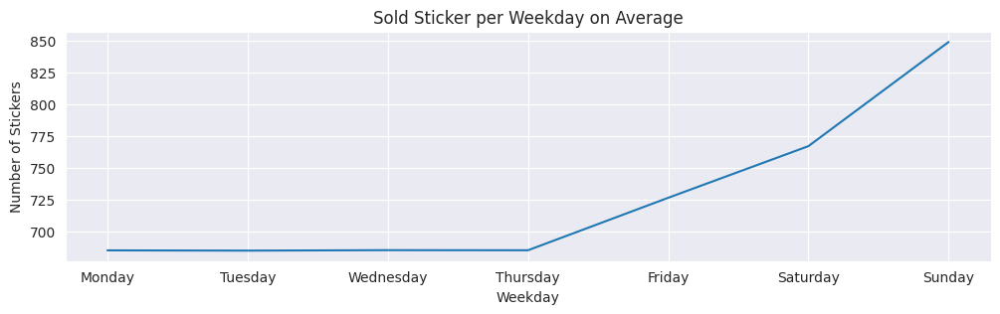

In [21]:
# Average week in terms of number of sold stickers for the train dataset
fig, ax = plt.subplots(1,figsize=(12,3))
train_df_imputed.groupby(train_df_imputed[DATE].dt.weekday)[NUM_SOLD].mean().plot.line(
    ax=ax,
    title="Sold Sticker per Weekday on Average", 
    ylabel="Number of Stickers",
    xlabel="Weekday",
)
ax.set_xticks(np.arange(0,7),['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
plt.show()

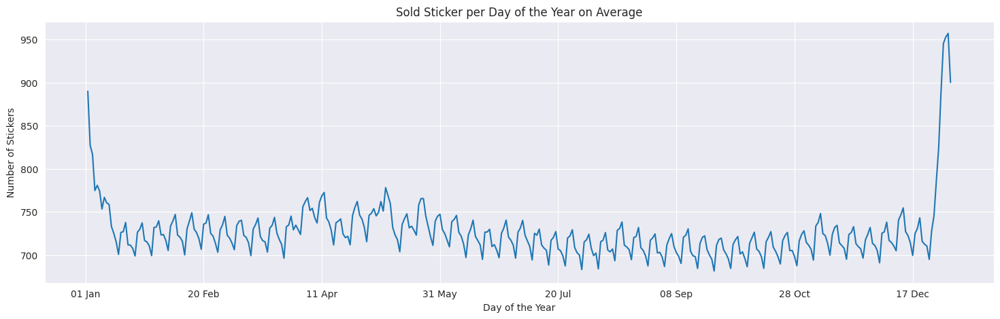

In [22]:
# Seasonal plots (yearly)
fig, ax = plt.subplots(1,figsize=(18,5))
train_df_imputed.groupby(train_df_imputed[DATE].dt.dayofyear)[NUM_SOLD].mean().plot.line(
    ax=ax,
    title="Sold Sticker per Day of the Year on Average", 
    ylabel="Number of Stickers",
    xlabel="Day of the Year",
)
ax.set_xticks(np.arange(0,351,50),[x.strftime('%d %b') for x in pd.to_datetime(np.arange(0,351,50),unit='D')])
plt.show()

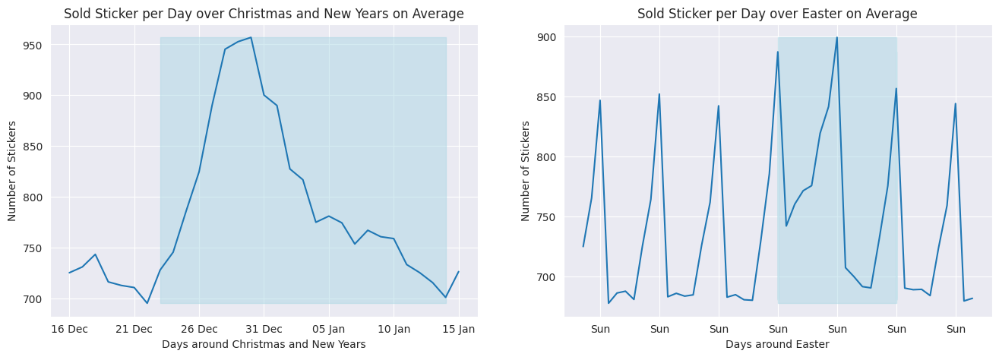

In [23]:
# Plot one month around the New Years
fig, (axL,axR) = plt.subplots(ncols=2,figsize=(16,5))
md = train_df_imputed.groupby(train_df_imputed[DATE].dt.dayofyear)[NUM_SOLD].mean()
newyear_df = pd.concat([md.iloc[350:366],md.iloc[0:15]]).reset_index()
newyear_df.plot.line(
    ax=axL,
    y=NUM_SOLD,
    title="Sold Sticker per Day over Christmas and New Years on Average", 
    ylabel="Number of Stickers",
    xlabel="Days around Christmas and New Years",
    legend=False,
)
xx = np.array(newyear_df.index[0:31:5].tolist())
axL.set_xticks(
  xx,
  [x.strftime('%d %b') 
    for x in pd.to_datetime(newyear_df.loc[0:31:5,DATE],unit='D',origin='1971-12-31')
  ] # origin has to be the end of ('leap year' - 2)
)
d1 = 7
d2 = 29
axL.fill_betweenx(newyear_df[NUM_SOLD].tolist(),d1, d2, color='lightblue', alpha=0.5, 
                  where = (newyear_df.index > 5) & (newyear_df.index < 15))
# Plot one month around the Easter holidays
dt = 23
half_period = pd.tseries.offsets.DateOffset(dt)
easter = { # Dates before and after Easter for each year from 2010 - 2016
  y: (e-half_period, e+half_period) 
    for y in range(2010, 2017) for e in [pd.to_datetime(1, unit="D", origin=str(y)) + pd.tseries.offsets.Easter()]
}
md = train_df_imputed[[DATE,NUM_SOLD]].loc[
  pd.DataFrame({
    yr: pd.Series(train_df_imputed[DATE].between(*easter[yr]).tolist(), name=str(yr)) for yr in range(2010,2017)
  }).any(axis=1)
].groupby(DATE, as_index=False, sort=False).mean() # Mean within each year
easter_df = md.assign(**{
  DATE: lambda x: x.groupby(md[DATE].dt.year, as_index=False, sort=False)[DATE].transform('rank').astype(int) - (dt + 1)
}).groupby(DATE, as_index=False, sort=False).mean() # Mean among years
easter_df.plot.line(
    ax=axR,
    y=NUM_SOLD,
    title="Sold Sticker per Day over Easter on Average", 
    ylabel="Number of Stickers",
    xlabel="Days around Easter",
    legend=False,
)
axR.set_xticks(
  easter_df.index[dt-(dt//7)*7:(dt+1)*2:7].tolist(),
  [x.strftime('%a') 
   for x in pd.to_datetime(easter_df.loc[dt-(dt//7)*7:(dt+1)*2:7,DATE], unit='D',origin='1973-06-17')
  ] # origin has to be on Sunday
)
d1 = dt
d2 = dt+14
axR.fill_betweenx(easter_df[NUM_SOLD],d1,d2, color='lightblue', alpha=0.5, where=(easter_df.index > dt-(dt//7)*7) & (easter_df.index <= dt+7))
plt.show()

In [24]:
# Feature engineering 
# Holidays for different countries.
import holidays
alpha2 = dict(zip(np.sort(train_df[COUNTRY].unique()), ['CA', 'FI', 'IT', 'KE', 'NO', 'SG']))
#h = {holidays.country_holidays(a, years=range(2010, 2020)) for _, a in alpha2.items()}
h = {d for _, a in alpha2.items() for d in holidays.country_holidays(a, years=range(2010, 2020)).keys() }
# Constants:
new_attributes = (
  'year', 'day_of_year', 'important_dates', 'quarter', 'month', 'month_sin', 'month_cos', 'week', 'weekday', 'weekend', 'day', 
  'christmas_and_new_years', 'after_new_years', 'easter', 'is_holiday',
  'day_atn1', 'day_tan1', 'day_atn3', 'day_tan3', 'day_atn5', 'day_tan5', 'day_atn7', 'day_tan7',
  'day_sin1', 'day_cos1', 'day_sin3', 'day_cos3', 'day_sin5', 'day_cos5', 'day_sin7', 'day_cos7',
  'day_atn2', 'day_tan2', 'day_atn4', 'day_tan4', 'day_atn6', 'day_tan6', 'day_atn8', 'day_tan8',
  'day_sin2', 'day_cos2', 'day_sin4', 'day_cos4', 'day_sin6', 'day_cos6', 'day_sin8', 'day_cos8',
)
# Used the upper case constants for variables in the attfunc dictionary.
for (v, w) in zip(map(str.upper, new_attributes), new_attributes):
    exec("%s = '%s'" % (v, w))

# Convenient function to determine Easter.
def is_easter(x):
    """
      This function identifies the easter for years between 2010 and 2019.
      Days outside first Easter week are numbered 0. Easter Sunday gets 1, and
      then increasing number during the Easter week.
    """
    days_before_easter = 0
    days_after_easter = 7
    easter = { # Dates defining the Easter week (Easter Sunday to next Sunday inclusive) for each year from 2010 - 2019
      y: (
          e-pd.tseries.offsets.DateOffset(days_before_easter), e+pd.tseries.offsets.DateOffset(days_after_easter)
      ) for y in range(2010, 2020) for e in [pd.to_datetime(1, unit="D", origin=str(y)) + pd.tseries.offsets.Easter()]
    }
    return [
      1 #((x.loc[i,DATE] - easter[x.loc[i,DATE].year][0]).days + 1)
      if ((x.loc[i,DATE] >= easter[x.loc[i,DATE].year][0]) & (x.loc[i,DATE] <= easter[x.loc[i,DATE].year][1]))
      else 0
      for i in x.index
    ]
# Convenient function to define how weeks are numbered.
def week_number(x):
    """
      Week starts on Monday, first week of the year is numbered 0.
      The first and the last weeks of the year can contain 1 to 7 days.
    """
    return (x[DATE].dt.day_of_year-x[DATE].dt.day_of_week+5)//7
# Attribute creation functions dictionary.
attfunc = {
  # Four digit year
  YEAR: lambda x: x[DATE].dt.year, 
  DAY_OF_YEAR: lambda x:  [
      x.loc[i,DATE].timetuple().tm_yday 
      if not (x.loc[i,DATE].is_leap_year and x.loc[i,DATE].month > 2) 
      else (x.loc[i,DATE].timetuple().tm_yday - 1) 
      for i in x.index
  ],
  IMPORTANT_DATES: lambda x: [
      x.loc[i,DAY_OF_YEAR] 
      if x.loc[i,DAY_OF_YEAR] in [1,2,3,4,5,6,7,8,9,10,99,100,101,125,126,355,256,357,358,359,360,361,362,363,364,365] 
      else 0 
      for i in x.index
  ],
  # Quarter: 1,2,3 or 4.
  QUARTER: lambda x: x[DATE].dt.quarter,
  # Month: 1 to 12.
  MONTH: lambda x: x[DATE].dt.month,
  MONTH_SIN: lambda x: np.sin(x[MONTH] * (2 * np.pi / 12)),
  MONTH_COS: lambda x: np.cos(x[MONTH] * (2 * np.pi / 12)),
  # Week number: 0 - 53.
  WEEK: week_number,
  # Weekday: 0 for Mon - Thu, 1 = Fri, 2 = Sat, 3 = Sun.
  WEEKDAY: lambda x: [max(0, x.loc[i,DATE].day_of_week - 3) for i in x.index],
  WEEKEND: lambda x: (x[DATE].dt.day_of_week > 4).astype(int),
  DAY: lambda x: x[DATE].dt.day,
  # Christmas and New Years: 0 for days other then 23 Dec - 4 January, that go from 1 at 23 Dec and increase to 13 at 4 Jan.
  CHRISTMAS_AND_NEW_YEARS: lambda x: [
           1 #(x.loc[i,DATE].day - 23 + 1 + 31*(1 - x.loc[i,DATE].month//12))
           if ((x.loc[i,DATE].month == 12) & (x.loc[i,DATE].day >= 23)) | ((x.loc[i,DATE].month == 1) & (x.loc[i,DATE].day <= 4))
           else 0
           for i in x.index
         ],
  # After New Years: 0 outside interval. From 5 January to 15 Janury increase from 1 at 5 Jan to 11 at 15 January.
  AFTER_NEW_YEARS: lambda x: [
              1 #(x.loc[i,DATE].day - 5 + 1)
              if (x.loc[i,DATE].month == 1) & (x.loc[i,DATE].day >= 5) & (x.loc[i,DATE].day <= 15)
              else 0
              for i in x.index
            ],
  # Easter: 0 outside first week of Easter. Otherwise 1 for Easter Sunday incremental to 8 at next Sunday.
  EASTER: is_easter,
  IS_HOLIDAY: lambda x: x[DATE].isin(h).astype(int), #[1 if x.loc[i,DATE].date() in h else 0 for i in x.index],
  DAY_ATN1: lambda x: np.arctan(x[WEEKDAY] * (1 * np.pi /  96)),
  DAY_TAN1: lambda x: np.tan (x[WEEKDAY] * (1 * np.pi /  96)),
  DAY_ATN3: lambda x: np.arctan (x[WEEKDAY] * (3 * np.pi /  96)),
  DAY_TAN3: lambda x: np.tan (x[WEEKDAY] * (3 * np.pi /  96)),
  DAY_ATN5: lambda x: np.arctan (x[WEEKDAY] * (5 * np.pi /  96)),
  DAY_TAN5: lambda x: np.tan (x[WEEKDAY] * (5 * np.pi /  96)),
  DAY_ATN7: lambda x: np.arctan (x[WEEKDAY] * (7 * np.pi /  96)),
  DAY_TAN7: lambda x: np.tan (x[WEEKDAY] * (7 * np.pi /  96)),
  DAY_SIN1: lambda x: np.sin (x[DAY_OF_YEAR] * (1 * np.pi /  365.0)),
  DAY_COS1: lambda x: np.cos (x[DAY_OF_YEAR] * (1 * np.pi /  365.0)),
  DAY_SIN3: lambda x: np.sin (x[DAY_OF_YEAR] * (3 * np.pi /  365.0)),
  DAY_COS3: lambda x: np.cos (x[DAY_OF_YEAR] * (3 * np.pi /  365.0)),
  DAY_SIN5: lambda x: np.sin (x[DAY_OF_YEAR] * (5 * np.pi /  365.0)),
  DAY_COS5: lambda x: np.cos (x[DAY_OF_YEAR] * (5 * np.pi /  365.0)),
  DAY_SIN7: lambda x: np.sin (x[DAY_OF_YEAR] * (7 * np.pi /  365.0)),
  DAY_COS7: lambda x: np.cos (x[DAY_OF_YEAR] * (7 * np.pi /  365.0)),
  DAY_ATN2: lambda x: np.arctan(x[WEEKDAY] * (2 * np.pi /  96)),
  DAY_TAN2: lambda x: np.tan(x[WEEKDAY] * (2 * np.pi /  96)),
  DAY_ATN4: lambda x: np.arctan(x[WEEKDAY] * (4 * np.pi /  96)),
  DAY_TAN4: lambda x: np.tan(x[WEEKDAY] * (4 * np.pi /  96)),
  DAY_ATN6: lambda x: np.arctan(x[WEEKDAY] * (6 * np.pi /  96)),
  DAY_TAN6: lambda x: np.tan(x[WEEKDAY] * (6 * np.pi /  96)),
  DAY_ATN8: lambda x: np.arctan(x[WEEKDAY] * (8 * np.pi /  96)),
  DAY_TAN8: lambda x: np.tan(x[WEEKDAY] * (8 * np.pi /  96)),
  DAY_SIN2: lambda x: np.sin (x[DAY_OF_YEAR] * (2 * np.pi /  365.0)),
  DAY_COS2: lambda x: np.cos (x[DAY_OF_YEAR] * (2 * np.pi /  365.0)),
  DAY_SIN4: lambda x: np.sin (x[DAY_OF_YEAR] * (4 * np.pi /  365.0)),
  DAY_COS4: lambda x: np.cos (x[DAY_OF_YEAR] * (4 * np.pi /  365.0)),
  DAY_SIN6: lambda x: np.sin (x[DAY_OF_YEAR] * (6 * np.pi /  365.0)),
  DAY_COS6: lambda x: np.cos (x[DAY_OF_YEAR] * (6 * np.pi /  365.0)),
  DAY_SIN8: lambda x: np.sin (x[DAY_OF_YEAR] * (8 * np.pi /  365.0)),
  DAY_COS8: lambda x: np.cos (x[DAY_OF_YEAR] * (8 * np.pi /  365.0)),
}

# Add columns for train and test datasets.
train_use_df = train_use_df.assign(**{n: attfunc[n] for n in new_attributes})
test_use_df = test_use_df.assign(**{n: attfunc[n] for n in new_attributes})

In [25]:
# This stuff is for the train_total_sales_df
train_df_tmp = train_use_df.copy()
test_df_tmp = test_use_df.copy()

# remove columns and apply get_dummies
train_df_tmp.drop(columns=[DATE], inplace=True)
test_df_tmp.drop(columns=[DATE], inplace=True)

train_df_tmp = pd.get_dummies(train_df_tmp, columns = [IMPORTANT_DATES, WEEKDAY], drop_first=True)
test_df_tmp = pd.get_dummies(test_df_tmp, columns = [IMPORTANT_DATES, WEEKDAY], drop_first=True)

train_final_df = train_df_tmp
test_final_df = test_df_tmp

In [26]:
y = train_final_df[DAY_NUM_SOLD]
X = train_final_df.drop(columns=DAY_NUM_SOLD)
X_test = test_final_df

X.head()

,year,day_of_week,day_of_year,quarter,month,month_sin,month_cos,week,weekend,day,...,important_dates_359,important_dates_360,important_dates_361,important_dates_362,important_dates_363,important_dates_364,important_dates_365,weekday_1,weekday_2,weekday_3
0,2010,4,1,1,1,0.5,0.866025,0,0,1,...,False,False,False,False,False,False,False,True,False,False
1,2010,5,2,1,1,0.5,0.866025,0,1,2,...,False,False,False,False,False,False,False,False,True,False
2,2010,6,3,1,1,0.5,0.866025,0,1,3,...,False,False,False,False,False,False,False,False,False,True
3,2010,0,4,1,1,0.5,0.866025,1,0,4,...,False,False,False,False,False,False,False,False,False,False
4,2010,1,5,1,1,0.5,0.866025,1,0,5,...,False,False,False,False,False,False,False,False,False,False


In [27]:
def plot_individual_ts(df):
    """Description of how the function works."""
    colour_map = {
        "Canada": "blue", "Finland": "orange", "Italy": "green",
        "Kenya": "red", "Norway": "purple", "Singapore": "brown"
    }
    
    for country in df[COUNTRY].unique():
        # Determine the number of subplots required
        num_plots = df[STORE].nunique() * df[PRODUCT].nunique()
        fig, axes = plt.subplots(num_plots, figsize=(20, 4*num_plots), constrained_layout=True)
        
        # Flatten axes for easier indexing if there's more than one subplot
        if num_plots > 1:
            axes = axes.flatten()
        else:
            axes = [axes]
        
        count = 0
        for store in df[STORE].unique():
            for product in df[PRODUCT].unique():
                # Filter data for the current product, store, and country
                plot_df = df.loc[
                    (df[PRODUCT] == product) &
                    (df[COUNTRY] == country) &
                    (df[STORE] == store)
                ]
                
                # Plot the line chart
                axes[count].plot(
                    plot_df[DATE], plot_df[NUM_SOLD],
                    linewidth=0.5, color=colour_map[country]
                )
                
                # Add titles and annotations
                axes[count].set_title(f"{country} - {store} - {product}")
                axes[count].axvline(pd.to_datetime("2017-01-01"), color='black', linestyle='--')
                axes[count].set_xlabel('Date')
                axes[count].set_ylabel('Number Sold')
                
                count += 1

        # Adjust layout for better readability
        plt.suptitle(f"Time Series Plots for {country}", fontsize=16)
        plt.show()

In [28]:
#plot_individual_ts(train_use_df)
#plot_individual_ts(train_use_df.loc[
#                   train_use_df[COUNTRY].isin(['Canada','Kenya']) &
#                   train_use_df[STORE].isin(['Stickers for Less', 'Premium Sticker Mart']) &
#                   train_use_df[PRODUCT].isin(['Holographic Goose']) 
#                   ])

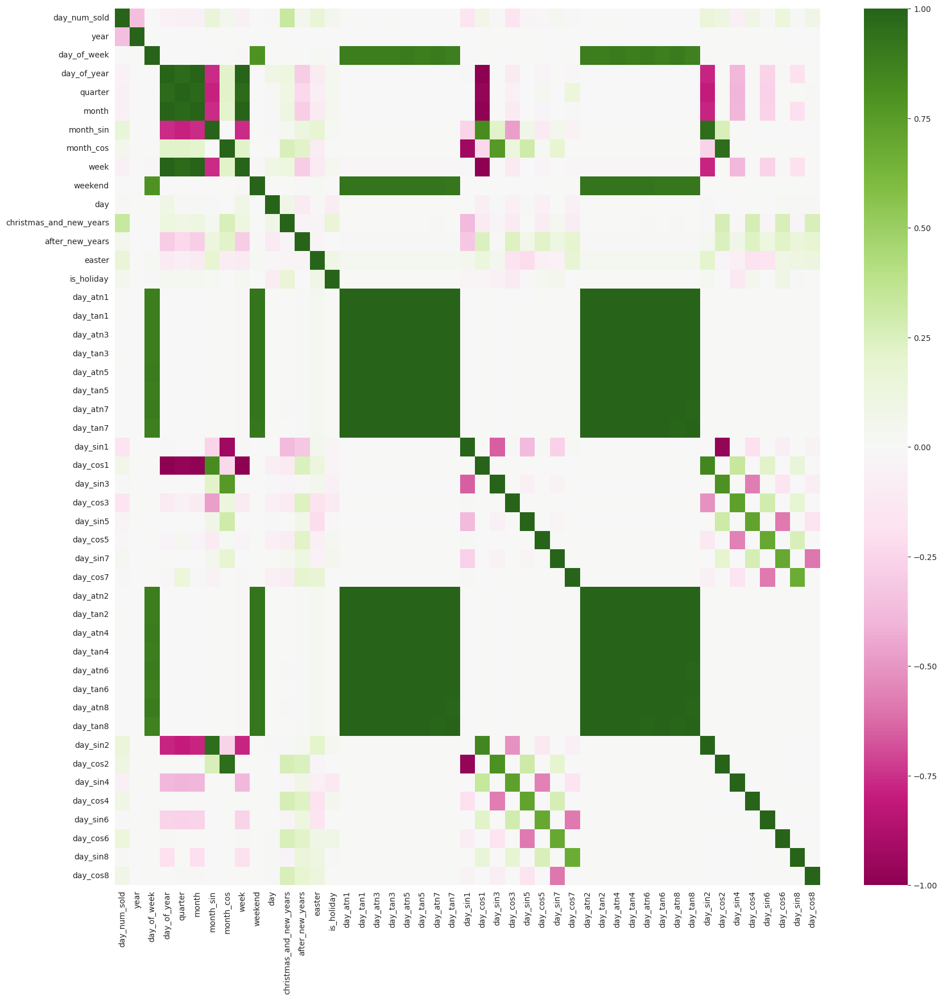

day_num_sold               1.00
year                      -0.36
day_of_week               -0.00
day_of_year               -0.05
quarter                   -0.06
month                     -0.06
month_sin                  0.16
month_cos                  0.06
week                      -0.06
weekend                   -0.00
day                        0.01
christmas_and_new_years    0.33
after_new_years            0.06
easter                     0.17
is_holiday                 0.05
day_atn1                  -0.00
day_tan1                  -0.00
day_atn3                  -0.00
day_tan3                   0.00
day_atn5                  -0.00
day_tan5                  -0.00
day_atn7                  -0.00
day_tan7                  -0.00
day_sin1                  -0.15
day_cos1                   0.07
day_sin3                  -0.01
day_cos3                  -0.15
day_sin5                  -0.03
day_cos5                  -0.02
day_sin7                   0.04
day_cos7                  -0.01
day_atn2

In [29]:
plt.figure(figsize  = (20, 20))

num_cols = train_final_df.select_dtypes(include = "number").columns.to_list()

corrl = train_final_df[num_cols].corr()
sns.heatmap(corrl, annot = False, vmin=-1, vmax=1, cmap = "PiYG")#cmap = "YlGnBu")

plt.show()
round(corrl.iloc[:,0],2)

In [30]:
train_final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2557 entries, 0 to 2556
Data columns (total 76 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   day_num_sold             2557 non-null   float64
 1   year                     2557 non-null   int32  
 2   day_of_week              2557 non-null   int32  
 3   day_of_year              2557 non-null   int64  
 4   quarter                  2557 non-null   int32  
 5   month                    2557 non-null   int32  
 6   month_sin                2557 non-null   float64
 7   month_cos                2557 non-null   float64
 8   week                     2557 non-null   int32  
 9   weekend                  2557 non-null   int64  
 10  day                      2557 non-null   int32  
 11  christmas_and_new_years  2557 non-null   int64  
 12  after_new_years          2557 non-null   int64  
 13  easter                   2557 non-null   int64  
 14  is_holiday              

# Build Models

In [31]:
class LinearModel1:
    def fit(self, X, y=None):
        pass

    def predict(self, X):
        return self.nonlinear(X)

    def nonlinear(self, X):
        y = (
            X.important_dates_1 * 14514.153142903406 +
            X.important_dates_6 +
            X.important_dates_99 -
            X.important_dates_359 +
            X.important_dates_363 * 23245.947607750375 +
            64795.970182750174 -
            ((X.important_dates_362 + np.sqrt(X.important_dates_364 + X.important_dates_365)) *
             ((X.important_dates_2 - X.important_dates_10) * (X.important_dates_101 + X.month_sin) +
              X.important_dates_362 - 19142.637752625015))
        )
        return y

class LinearModel2:
    def fit(self, X, y=None):
        pass

    def predict(self, X):
        return self.nonlinear(X)

    def nonlinear(self, X):
        y = X.month_sin*210.148+\
            (X.important_dates_1+X.important_dates_362+X.important_dates_363+X.important_dates_364+X.important_dates_365)*19472.7071+\
            X.important_dates_4*X.month_sin+\
            65141.2073
            
        return y

In [32]:
regressors = {
    "Ridge" : Ridge(tol=1e-2, max_iter=1000000, random_state=0),
    "Lasso" : Lasso(tol=1e-2, max_iter=1000000, random_state=0),
    #"nonlinear1" : LinearModel1(),
    #"nonlinear2" : LinearModel2(),
    "LGBM1": LGBMRegressor(**{'objective': 'regression_l2',
                               'metric': 'mape', 
                               'max_depth': 7,
                               'num_leaves': 123, 
                               'min_child_samples': 21,
                               'min_child_weight': 24,
                               'colsample_bytree': 0.3641261996760593, 
                               'reg_alpha': 0.03632800166349373, 
                               'reg_lambda': 0.5287861861476272,
                               'random_state': 42,
                               'early_stopping_round':200,
                               'verbose': -1,
                               'boosting_type': 'gbdt',
                               'n_estimators': 3000,
                               'learning_rate': 0.01,
                               }),
    "LGBM2": LGBMRegressor(**{'objective': 'regression_l2',
                               'metric': 'mape',
                               'max_depth': 6,
                               'num_leaves': 502,
                               'min_child_samples': 23,
                               'min_child_weight': 18, 
                               'colsample_bytree': 0.4714820876493163, 
                               'reg_alpha': 0.054972003081022576, 
                               'reg_lambda': 0.5774608955362155,
                               'random_state': 42,
                               'early_stopping_round': 200,
                               'verbose': -1,
                               'boosting_type': 'goss',
                               'n_estimators': 3000,
                               'learning_rate': 0.01,
                              }),
    "LGBM3": LGBMRegressor(**{'objective': 'regression_l2', 
                               'metric': 'mape',
                               'max_depth': 14,
                               'num_leaves': 279,
                               'min_child_samples': 7,
                               'min_child_weight': 24, 
                               'colsample_bytree': 0.43218993309765835,
                               'reg_alpha': 0.42757392987472964,
                               'reg_lambda': 0.9039762787446107,
                               'random_state': 42,
                               'early_stopping_round': 200,
                               'verbose': -1,
                               'boosting_type': 'goss',
                               'n_estimators': 3000,
                               'learning_rate': 0.01,
                               }),

}

In [33]:
X.head()

,year,day_of_week,day_of_year,quarter,month,month_sin,month_cos,week,weekend,day,...,important_dates_359,important_dates_360,important_dates_361,important_dates_362,important_dates_363,important_dates_364,important_dates_365,weekday_1,weekday_2,weekday_3
0,2010,4,1,1,1,0.5,0.866025,0,0,1,...,False,False,False,False,False,False,False,True,False,False
1,2010,5,2,1,1,0.5,0.866025,0,1,2,...,False,False,False,False,False,False,False,False,True,False
2,2010,6,3,1,1,0.5,0.866025,0,1,3,...,False,False,False,False,False,False,False,False,False,True
3,2010,0,4,1,1,0.5,0.866025,1,0,4,...,False,False,False,False,False,False,False,False,False,False
4,2010,1,5,1,1,0.5,0.866025,1,0,5,...,False,False,False,False,False,False,False,False,False,False


In [34]:
n_folds = 5

for key, reg in regressors.items():
    test_preds = np.zeros(len(X_test))
    oof_full = y.copy()

    start = time.time()

    cv = KFold(n_splits=n_folds, shuffle=False)
    score=0
    for fold, (train_idx, val_idx) in enumerate(cv.split(X, y)):
        X_train, X_valid = X.iloc[train_idx], X.iloc[val_idx]
        y_train, y_valid = y.iloc[train_idx], y.iloc[val_idx]
        #start = time.time()
        if "LGBM" in key:
            reg.fit(X_train, y_train,
                   eval_set = [(X_valid, y_valid)], 
                                       callbacks = [log_evaluation(0),
                                                    early_stopping(200, verbose = False)
                                                   ])
            
        else:
            reg.fit(X_train, y_train)
        oof_preds = reg.predict(X_valid)
        score += mean_absolute_percentage_error(y_valid, oof_preds)/n_folds
        oof_full[val_idx] = oof_preds
        
        test_preds += reg.predict(X_test)/n_folds
    
    # Stop timer
    stop = time.time()
    
    print('Model:', key)
    print('Average validation MAPE:', score)
    print(f"Training time (min:sec): {(stop - start)//60:0.0f}:{((stop - start)%60):0.3f}")
    print('')
    

    oof_full.to_csv(f"{key}_oof_preds.csv", index=False)
    ss = pd.DataFrame()
    ss[DAY_NUM_SOLD] = test_preds
    ss.to_csv(f"{key}_test_preds.csv", index=False)

Model: Ridge
Average validation MAPE: 0.11559400308815053
Training time (min:sec): 0:0.130

Model: Lasso
Average validation MAPE: 0.11569151524179042
Training time (min:sec): 0:20.685

Model: LGBM1
Average validation MAPE: 0.044832723245713746
Training time (min:sec): 0:4.335

Model: LGBM2
Average validation MAPE: 0.043963404162782424
Training time (min:sec): 0:2.771

Model: LGBM3
Average validation MAPE: 0.04413639382724632
Training time (min:sec): 0:8.488



In [36]:
p="/kaggle/working/"
p ="./"
oof_df = pd.DataFrame(index=np.arange(len(y)))
for i in regressors.keys():
    df = pd.read_csv(p + f"{i}_oof_preds.csv")
    df.rename(columns={DAY_NUM_SOLD: i}, inplace=True)
    oof_df = pd.concat([oof_df,df], axis=1)
    
# Join test preds
test_preds = pd.DataFrame(index=np.arange(len(X_test)))
for i in regressors.keys():
    df = pd.read_csv(p + f"{i}_test_preds.csv")
    df.rename(columns={DAY_NUM_SOLD: i}, inplace=True)
    test_preds = pd.concat([test_preds,df], axis=1)
    
oof_df.head(3)

,Ridge,Lasso,LGBM1,LGBM2,LGBM3
0,87140.472577,87520.327409,66163.49194,65801.658145,65800.168663
1,82411.074235,81778.279382,66163.49194,65801.658145,65800.168663
2,81067.196145,81000.592571,66163.49194,65801.658145,65800.168663


In [37]:
# Evaluate oof preds
scores = {}
for col in oof_df.columns:
    scores[col] = mean_absolute_percentage_error(y, oof_df[col])

# Sort scores
    scores = {k: v for k, v in sorted(scores.items(), key=lambda item: item[1], reverse=False)}

# Sort oof_df and test_preds
oof_df = oof_df[list(scores.keys())]
test_preds = test_preds[list(scores.keys())]

scores

{'LGBM2': 0.04397570508831676,
 'LGBM3': 0.04414803636649444,
 'LGBM1': 0.0448455753463221,
 'Ridge': 0.1156282801722609,
 'Lasso': 0.11572590628915119}

In [38]:
# Initialise
STOP = False
current_best_ensemble = oof_df.iloc[:,0]
current_best_test_preds = test_preds.iloc[:,0]
MODELS = oof_df.iloc[:,1:]
weight_range = np.arange(-1,1,0.001)  
history = [mean_absolute_percentage_error(y, current_best_ensemble)]
i=0

# Hill climbing
while not STOP:
    i+=1
    potential_new_best_cv_score = mean_absolute_percentage_error(y, current_best_ensemble)
    k_best, wgt_best = None, None
    for k in MODELS:
        for wgt in weight_range:
            potential_ensemble = (1-wgt) * current_best_ensemble + wgt * MODELS[k]
            cv_score = mean_absolute_percentage_error(y, potential_ensemble)
            if cv_score < potential_new_best_cv_score:
                potential_new_best_cv_score = cv_score
                k_best, wgt_best = k, wgt
            
    if k_best is not None:
        current_best_ensemble = (1-wgt_best) * current_best_ensemble + wgt_best * MODELS[k_best]
        current_best_test_preds = (1-wgt_best) * current_best_test_preds + wgt_best * test_preds[k_best]
        MODELS.drop(k_best, axis=1, inplace=True)
        if MODELS.shape[1]==0:
            STOP = True
        print(f'Iteration: {i}, Model added: {k_best}, Best weight: {wgt_best:}, Best MAPE: {potential_new_best_cv_score:.5f}')
        history.append(potential_new_best_cv_score)
    else:
        STOP = True

Iteration: 1, Model added: Ridge, Best weight: -0.18199999999999927, Best MAPE: 0.04177
Iteration: 2, Model added: LGBM1, Best weight: -0.13299999999999923, Best MAPE: 0.04173
Iteration: 3, Model added: LGBM3, Best weight: 0.20600000000000107, Best MAPE: 0.04162
Iteration: 4, Model added: Lasso, Best weight: -0.01899999999999913, Best MAPE: 0.04160


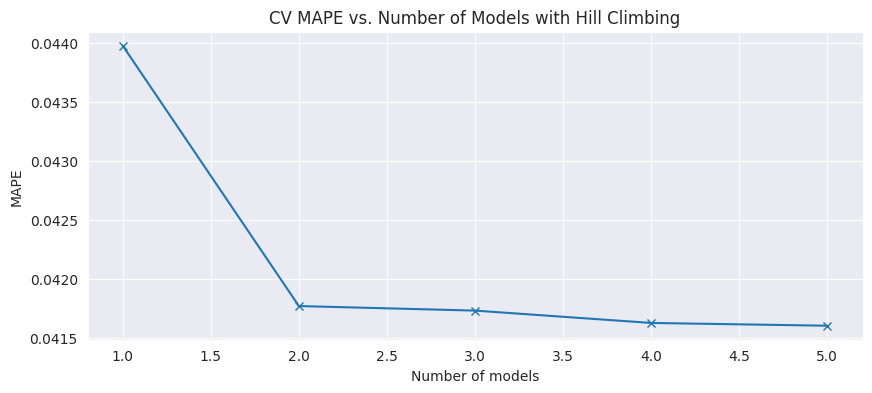

In [39]:
plt.figure(figsize=(10,4))
plt.plot(np.arange(len(history))+1, history, marker="x")
plt.title("CV MAPE vs. Number of Models with Hill Climbing")
plt.xlabel("Number of models")
plt.ylabel("MAPE")
plt.show()

# Prediction & Submission

In [40]:
test_total_sales_df = test_total_sales_df.assign(**{
    DAY_NUM_SOLD: current_best_test_preds.reset_index(drop=True)*0.5+LinearModel2().predict(X_test).reset_index(drop=True)*0.5
})

In [41]:
train_total_sales_df

,date,day_num_sold,year,day_of_week
0,2010-01-01,85710.772635,2010,4
1,2010-01-02,82699.983533,2010,5
2,2010-01-03,88476.100742,2010,6
3,2010-01-04,68206.468049,2010,0
4,2010-01-05,65832.192575,2010,1
...,...,...,...,...
2552,2016-12-27,64651.885691,2016,1
2553,2016-12-28,71252.729934,2016,2
2554,2016-12-29,77548.729112,2016,3
2555,2016-12-30,82028.751480,2016,4


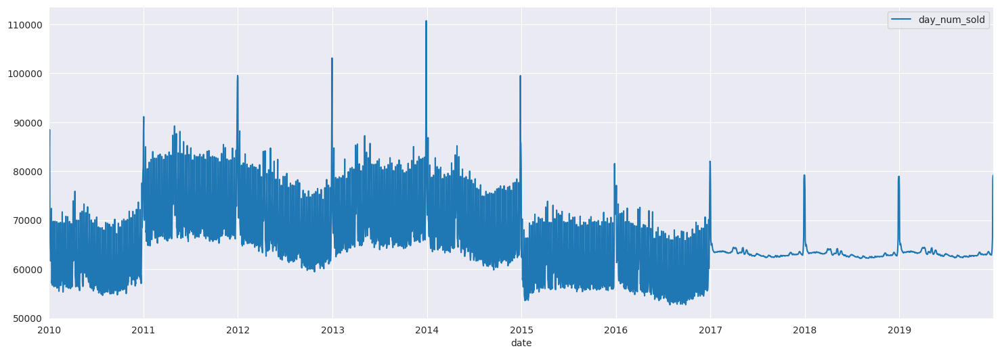

In [42]:
cols = [DATE, DAY_NUM_SOLD]
fig,ax = plt.subplots(1,figsize=(18,6))
(pd.concat([train_total_sales_df[cols],test_total_sales_df[cols]])).set_index(DATE).plot(ax=ax)
plt.show()

In [43]:
product_ratio_2017_df = product_ratio_df.loc[product_ratio_df[DATE].dt.year == 2015].copy()
product_ratio_2018_df = product_ratio_df.loc[product_ratio_df[DATE].dt.year == 2016].copy()
product_ratio_2019_df = product_ratio_df.loc[product_ratio_df[DATE].dt.year == 2015].copy()

product_ratio_2017_df[DATE] = product_ratio_2017_df[DATE] + pd.DateOffset(years=2)
product_ratio_2018_df[DATE] = product_ratio_2018_df[DATE] + pd.DateOffset(years=2)
product_ratio_2019_df[DATE] = product_ratio_2019_df[DATE] + pd.DateOffset(years=4)

forecasted_ratios_df = pd.concat([product_ratio_2017_df, product_ratio_2018_df, product_ratio_2019_df])
display(forecasted_ratios_df)

,date,product,product_ratio
9130,2017-01-01,Holographic Goose,0.053755
9131,2017-01-01,Kaggle,0.350044
9132,2017-01-01,Kaggle Tiers,0.263057
9133,2017-01-01,Kerneler,0.155640
9134,2017-01-01,Kerneler Dark Mode,0.177505
...,...,...,...
10950,2019-12-31,Holographic Goose,0.050794
10951,2019-12-31,Kaggle,0.331864
10952,2019-12-31,Kaggle Tiers,0.290504
10953,2019-12-31,Kerneler,0.153052


In [44]:
test_sub_df = test_df.merge( # Adding total sales predictions
  test_total_sales_df[[DATE, DAY_OF_WEEK, DAY_NUM_SOLD]], how="left", on=DATE
).merge( # Adding in the store ratios
  store_weights.reset_index(), how="left", on=STORE
).merge( # Adding in the gdp country ratios
  gdp_per_capita_ratios_df[[YEAR,COUNTRY,GDP_RATIO]], how="left", on=[YEAR, COUNTRY]
).merge( # Adding in the product ratios
  forecasted_ratios_df, how="left", on=[DATE, PRODUCT]
).assign(**{
  DAY_OF_WEEK: lambda x: x[DATE].dt.day_of_week
}).merge( # Adding in the week ratios
  day_of_week_ratio.reset_index(), how="left", on=DAY_OF_WEEK
).assign(**{ # Some Kenya stuff here ?!
  GDP_RATIO: lambda x: x[GDP_RATIO].where(x[COUNTRY] != 'Kenya', x[GDP_RATIO] - 0.0007/2)
}).assign(**{ # Disaggregating the forecast
 NUM_SOLD: lambda x:
    x[DAY_NUM_SOLD] * 
    x[DAY_OF_WEEK_RATIO] * # To correct for normalisation earlier (using global average ratios)
    x[STORE_RATIO] *       # To differentiate store sales (using global average ratios)
    x[GDP_RATIO] *         # To differentiate countries (using known gdp ratios)
    x[PRODUCT_RATIO]       # To differentiate products sale for each day (using 2015-ratios for 2017 and 2019 and 2016-ratios for 2018)
})
test_sub_df

,date,country,store,product,year,day_of_week,day_num_sold,store_ratio,gdp_country_ratio,product_ratio,day_of_week_ratio,num_sold
0,2017-01-01,Canada,Discount Stickers,Holographic Goose,2017,6,76548.087547,0.184703,0.172210,0.053755,1.168905,152.989583
1,2017-01-01,Canada,Discount Stickers,Kaggle,2017,6,76548.087547,0.184703,0.172210,0.350044,1.168905,996.247002
2,2017-01-01,Canada,Discount Stickers,Kaggle Tiers,2017,6,76548.087547,0.184703,0.172210,0.263057,1.168905,748.677042
3,2017-01-01,Canada,Discount Stickers,Kerneler,2017,6,76548.087547,0.184703,0.172210,0.155640,1.168905,442.960894
4,2017-01-01,Canada,Discount Stickers,Kerneler Dark Mode,2017,6,76548.087547,0.184703,0.172210,0.177505,1.168905,505.189878
...,...,...,...,...,...,...,...,...,...,...,...,...
98635,2019-12-31,Singapore,Premium Sticker Mart,Holographic Goose,2019,1,79101.192347,0.441551,0.241431,0.050794,0.943297,404.031600
98636,2019-12-31,Singapore,Premium Sticker Mart,Kaggle,2019,1,79101.192347,0.441551,0.241431,0.331864,0.943297,2639.767446
98637,2019-12-31,Singapore,Premium Sticker Mart,Kaggle Tiers,2019,1,79101.192347,0.441551,0.241431,0.290504,0.943297,2310.779547
98638,2019-12-31,Singapore,Premium Sticker Mart,Kerneler,2019,1,79101.192347,0.441551,0.241431,0.153052,0.943297,1217.429988


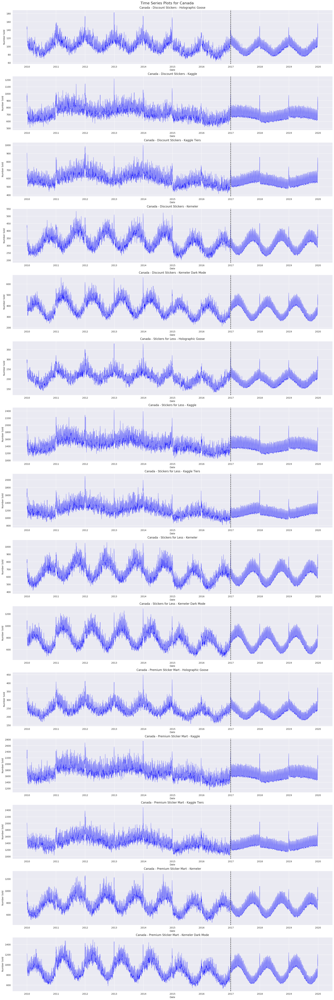

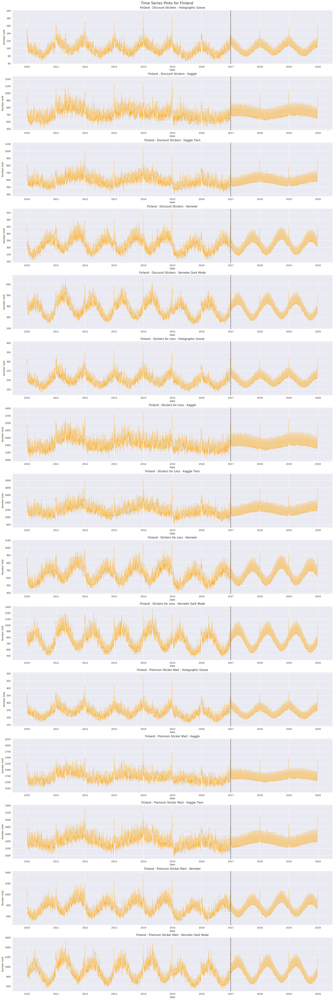

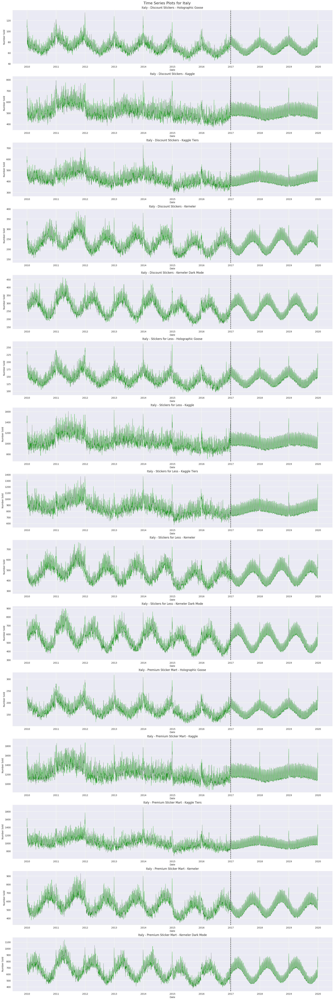

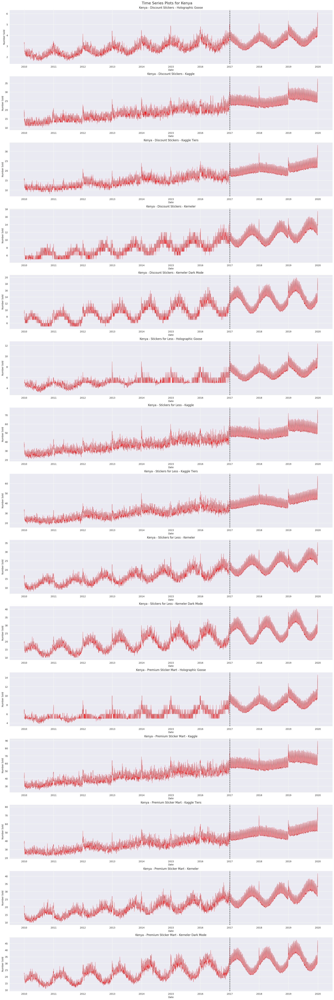

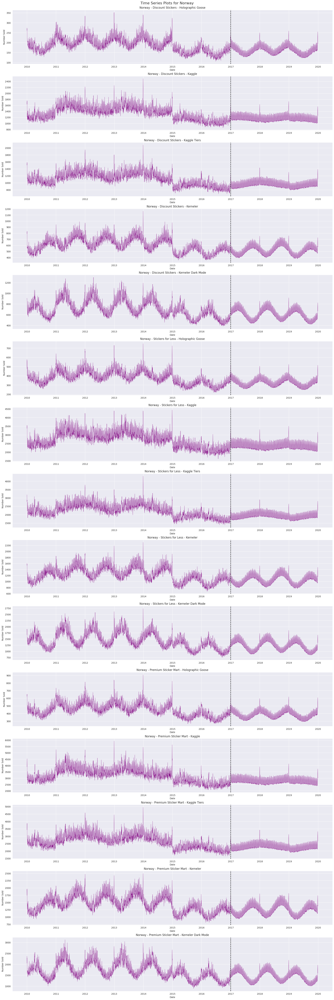

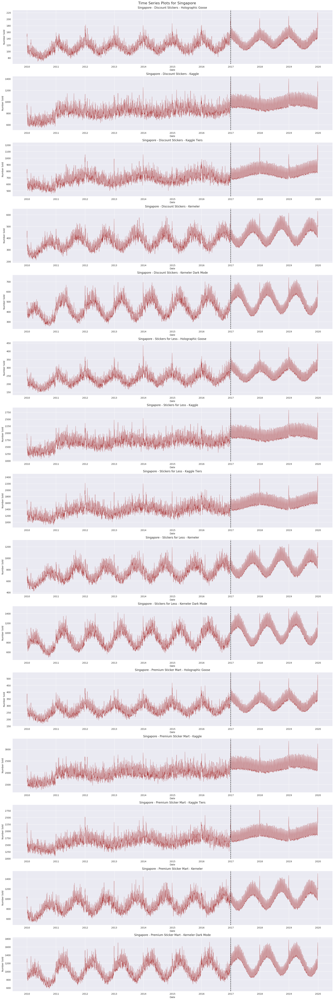

In [45]:
cols = [DATE,COUNTRY,STORE,PRODUCT,NUM_SOLD]
plot_individual_ts(pd.concat([train_df_imputed[cols],test_sub_df[cols]]))

In [46]:
submission = pd.read_csv(path + "sample_submission.csv")
submission[NUM_SOLD] = test_sub_df[NUM_SOLD].round()
display(submission.head())

,id,num_sold
0,230130,153.0
1,230131,996.0
2,230132,749.0
3,230133,443.0
4,230134,505.0


In [47]:
submission.to_csv('submission.csv', index = False)